# Labolatorium 2:  Arytmetyka komputerowa
Jakub Fabia

## Importowanie bibliotek

Importuję niezbędne biblioteki. Biblioteki te obejmują:
- `DataFrames` do manipulacji danymi w formie tabelarycznej,
- `Plots` do tworzenia wykresów,
- `QuadGK` do dokładnych obliczeń całki (w zadaniu 4),

In [2]:
using DataFrames
using Plots
using QuadGK

## Zadanie 1

Liczby znormalizowane w standardzie IEEE-754 są odczytywane z pamięci do poniższej postaci:

$L = (-1)^{znak} * 1.mantysa * 2^{cecha-bias}$

### Funkcje 

In [3]:
decode(x::Float16) = (b=bitstring(x); (string("Znak: ", b[1], "  Cecha: ", b[2:6], "  Mantysa: ", b[7:16])))
decode(x::Float32) = (b=bitstring(x); (string("Znak: ", b[1], "  Cecha: ", b[2:9], "  Mantysa: ", b[10:32])))
decode(x::Float64) = (b=bitstring(x); (string("Znak: ", b[1], "  Cecha: ", b[2:12], "  Mantysa: ", b[13:64])))

decode (generic function with 3 methods)

In [4]:
function bit_represent(x)
    println(string("Liczba: ", x))
    println(string("Reprezentacja binarna: ", bitstring(x)))
    println(decode(x))
end

bit_represent (generic function with 1 method)

### Przedstawienie liczby 1/3

In [5]:
x = Float16(1/3)
bit_represent(x)

Liczba: 0.3333
Reprezentacja binarna: 0011010101010101
Znak: 0  Cecha: 01101  Mantysa: 0101010101


In [6]:
x = Float32(1/3)
bit_represent(x)

Liczba: 0.33333334
Reprezentacja binarna: 00111110101010101010101010101011
Znak: 0  Cecha: 01111101  Mantysa: 01010101010101010101011


In [7]:
x = Float64(1/3)
bit_represent(x)

Liczba: 0.3333333333333333
Reprezentacja binarna: 0011111111010101010101010101010101010101010101010101010101010101
Znak: 0  Cecha: 01111111101  Mantysa: 0101010101010101010101010101010101010101010101010101


### Rzutowanie Float16 na Float64

In [8]:
x = Float16(3.14159)
y = Float64(x)
bit_represent(x)
bit_represent(y)

Liczba: 3.14


Reprezentacja binarna: 0100001001001000
Znak: 0  Cecha: 10000  Mantysa: 1001001000
Liczba: 3.140625
Reprezentacja binarna: 0100000000001001001000000000000000000000000000000000000000000000
Znak: 0  Cecha: 10000000000  Mantysa: 1001001000000000000000000000000000000000000000000000


In [9]:
x = Float16(3/7)
y = Float64(x)
bit_represent(x)
bit_represent(y)

Liczba: 0.4285
Reprezentacja binarna: 0011011011011011
Znak: 0  Cecha: 01101  Mantysa: 1011011011
Liczba: 0.428466796875
Reprezentacja binarna: 0011111111011011011011000000000000000000000000000000000000000000
Znak: 0  Cecha: 01111111101  Mantysa: 1011011011000000000000000000000000000000000000000000


## Zadanie 2

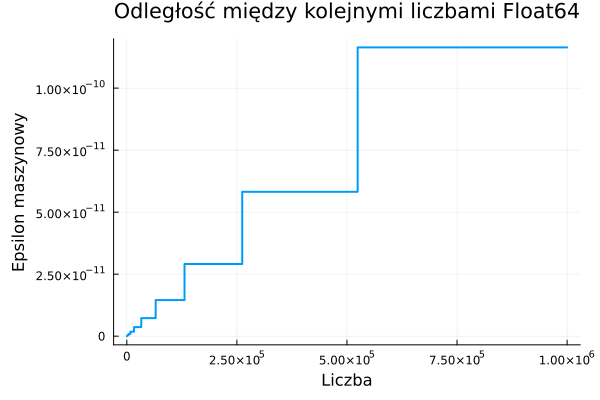

In [10]:
plot(
    1.0:1.0:1000000.0, 
    eps,
    linewidth=2,
    xlabel="Liczba", 
    ylabel="Epsilon maszynowy", 
    title="Odległość między kolejnymi liczbami Float64", 
    margin=3Plots.mm,
    legend=false
)

## Zadanie 3

### Rozwiązanie w języku C - plik main.c

```c
#include <stdio.h>
#include <gsl/gsl_ieee_utils.h>

int main(){
    float x = 3e-35;
    for(int i = 0; i <= 34; i++){
        x = x / (2.0);
        gsl_ieee_printf_float(&x);
        printf("\n");
    }
    return 0;
}
```

### Wyniki:

```bash
$ gcc -Wall main.c -lgsl -o main
$ ./main
 1.00111111000000111100010*2^-116
 1.00111111000000111100010*2^-117
 1.00111111000000111100010*2^-118
 1.00111111000000111100010*2^-119
 1.00111111000000111100010*2^-120
 1.00111111000000111100010*2^-121
 1.00111111000000111100010*2^-122
 1.00111111000000111100010*2^-123
 1.00111111000000111100010*2^-124
 1.00111111000000111100010*2^-125
 1.00111111000000111100010*2^-126 // tutaj ostatnia znormalizowana liczba
 0.10011111100000011110001*2^-126
 0.01001111110000001111000*2^-126
 0.00100111111000000111100*2^-126
 0.00010011111100000011110*2^-126
 0.00001001111110000001111*2^-126
 0.00000100111111000001000*2^-126
 0.00000010011111100000100*2^-126
 0.00000001001111110000010*2^-126
 0.00000000100111111000001*2^-126
 0.00000000010011111100000*2^-126
 0.00000000001001111110000*2^-126
 0.00000000000100111111000*2^-126
 0.00000000000010011111100*2^-126
 0.00000000000001001111110*2^-126
 0.00000000000000100111111*2^-126
 0.00000000000000010100000*2^-126
 0.00000000000000001010000*2^-126
 0.00000000000000000101000*2^-126
 0.00000000000000000010100*2^-126
 0.00000000000000000001010*2^-126
 0.00000000000000000000101*2^-126
 0.00000000000000000000010*2^-126
 0.00000000000000000000001*2^-126
 0

```

### Wnioski
Przejście do postaci denormalizowanej następuje, gdy program próbuje obniżyć wartość zmiennej poniżej $2^{-126}$. Denormalizowane liczby pozwala na stopniowe zanikanie wartości (gradual underflow) zamiast nagłego przejścia do zera. Dzięki temu możliwe jest reprezentowanie bardzo małych liczb kosztem zmniejszonej precyzji, zamiast całkowitej utraty informacji.

## Zadanie 4

### Cel algorytmu

Zadaniem poniższych funkcji jest aproksymowanie wartości wyrażenia $\int_0^1 x^n * e^{x-1} dx$  dla  $n \geq 1$

Całkę tą policzę dokładnie z wykorzystaniem biblioteki, która wykorzystuje kwadraturę Gaussa-Kronroda.

In [11]:
function integral(n)
    integrand(x) = x^n * exp(x - 1)
    integral_value = quadgk(integrand, 0.0, 1.0)[1]
    return integral_value
end

integral (generic function with 1 method)

### Wersja niestabilna

$I_n = \int_0^1 x^n * e^{x-1} dx$

Całkuję przez części

$I_n = \left[ x^n e^{x-1} \right]_0^1 - \int_0^1 n x^{n-1} e^{x-1} \,dx$

$\left[ x^n e^{x-1} \right]_0^1 = 1 - 0 = 1$

$I_n = 1 - n I_{n-1}$

$I_1 = \int_0^1 x^1 * e^{x-1} dx = \left[ (x-1) e^{x-1} \right]_0^1 = \frac{1}{e}$

In [12]:
function not_stable_approx(n) 
    if n == 1
        return 1/exp(1)
    end
    return ((1 - n * not_stable_approx(n-1)))
end

not_stable_approx (generic function with 1 method)

In [13]:
dfBad = DataFrame(notStable = Float64[], integral = Float64[], difference = Float64[])
for i in 1:100
    s = not_stable_approx(i)
    int_val = integral(i)
    diff = s - int_val
    push!(dfBad, [s, int_val, diff])
end
show(dfBad)

100×3 DataFrame
 Row │ notStable     integral    difference
     │ Float64       Float64     Float64
─────┼────────────────────────────────────────
   1 │  0.367879     0.367879     0.0
   2 │  0.264241     0.264241     0.0
   3 │  0.207277     0.207277     5.55112e-17
   4 │  0.170893     0.170893    -2.77556e-16
   5 │  0.145533     0.145533     1.4988e-15
   6 │  0.126802     0.126802    -8.96505e-15
   7 │  0.112384     0.112384     6.26582e-14
   8 │  0.100932     0.100932    -5.01099e-13
   9 │  0.0916123    0.0916123    4.51017e-12
  10 │  0.0838771    0.0838771   -4.51014e-11
  11 │  0.0773522    0.0773522    4.96116e-10
  ⋮  │      ⋮            ⋮            ⋮
  91 │  1.68037e123  0.0107539    1.68037e123
  92 │ -1.54594e125  0.0106395   -1.54594e125
  93 │  1.43772e127  0.0105275    1.43772e127
  94 │ -1.35146e129  0.0104178   -1.35146e129
  95 │  1.28389e131  0.0103104    1.28389e131
  96 │ -1.23253e133  0.0102051   -1.23253e133
  97 │  1.19556e135  0.010102     1.19556e135
 

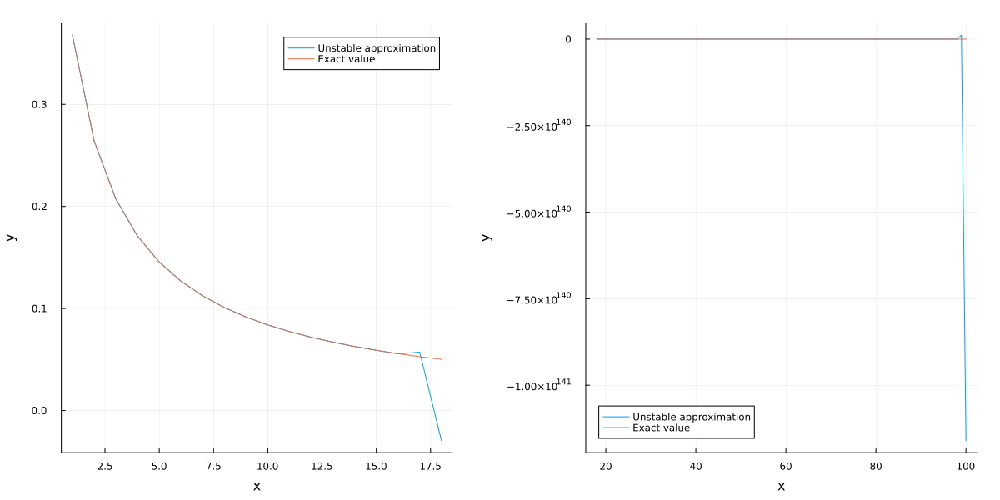

In [14]:
goodRange = 1:18
badRange = 18:100
p1 = plot(goodRange, dfBad[goodRange, :notStable],label="Unstable approximation",xlabel = "x",ylabel = "y",margin = 5Plots.mm)
plot!(goodRange, dfBad[goodRange, :integral],label="Exact value",xlabel = "x",ylabel = "y",margin = 5Plots.mm)
p2 = plot(badRange, dfBad[badRange, :notStable],label="Unstable approximation",xlabel = "x",ylabel = "y",margin = 5Plots.mm)
plot!(badRange, dfBad[badRange, :integral],label="Exact value",xlabel = "x",ylabel = "y",margin = 5Plots.mm)
plot(p1, p2, layout=(1,2), size=(1200, 600))

Algorytm ten nie jest stabilny i dla wartości powyżej n = 17 zwraca całkowicie błędne wyniki. Jego niestabilność wynika z faktu, że błąd początkowy $\epsilon(I_1)$ z każdym kolejnym etapem się nasila. 

Dla każdego następnego $I_n$ błąd wynosi: $\epsilon(I_1)* n!$.

A zatem błąd algorytmu przenosi się dalej z rosnącą amplitudą.

### Propozycja wersji stabilnej

Po przekształceniu $I_n = 1 - n I_{n-1}$ można otrzymać:

$I_{n-1} = \frac{1 - I_{n}}{n}$

Oraz korzystając z nierówności

$I_n = \int_0^1 x^n * e^{x-1} dx \leq \int_0^1 x^n dx = \left[ \frac{x^{n+1}}{n+1} \right]_0^1 = \frac{1}{n+1}$

Oraz:

$\lim_{n\rightarrow \infty} I_n = 0$

To przy założeniu, że np. $I_{20000} \approx \frac{1}{20000+1}$, to błąd każdej kolejnej liczby będzie wynosił $\epsilon(I_n) * \frac{n!}{20001!}$

In [15]:
function stable_approx()
    cashe = zeros(Float64, 20000)
    cashe[20000] = 1/20001
    for i in 19999:-1:1
        cashe[i] = (1 - cashe[i+1])/(i+1)
    end
    return cashe
end

stable_approx (generic function with 1 method)

In [16]:
goodDf = DataFrame(stable = Float64[], integral = Float64[], difference = Float64[])
cashe = stable_approx()

for i in 1:20000
    s = cashe[i]
    int_val = integral(i)
    diff = s - int_val
    push!(goodDf, [s, int_val, diff])
end

show(goodDf)

20000×3 DataFrame
   Row │ stable      integral    difference
       │ Float64     Float64     Float64
───────┼──────────────────────────────────────
     1 │ 0.367879    0.367879     0.0
     2 │ 0.264241    0.264241     0.0
     3 │ 0.207277    0.207277     0.0
     4 │ 0.170893    0.170893     0.0
     5 │ 0.145533    0.145533     2.77556e-17
     6 │ 0.126802    0.126802    -2.77556e-17
     7 │ 0.112384    0.112384     1.38778e-17
     8 │ 0.100932    0.100932     2.77556e-17
     9 │ 0.0916123   0.0916123    2.77556e-17
    10 │ 0.0838771   0.0838771    2.77556e-17
    11 │ 0.0773522   0.0773522   -2.77556e-17
   ⋮   │     ⋮           ⋮            ⋮
 19991 │ 5.00175e-5  5.00175e-5  -1.82959e-18
 19992 │ 5.0015e-5   5.0015e-5   -1.83637e-18
 19993 │ 5.00125e-5  5.00125e-5  -1.8567e-18
 19994 │ 5.001e-5    5.001e-5    -1.83637e-18
 19995 │ 5.00075e-5  5.00075e-5  -1.8567e-18
 19996 │ 5.0005e-5   5.0005e-5   -1.84992e-18
 19997 │ 5.00025e-5  5.00025e-5  -1.84992e-18
 19998 │ 5.0e-5 

Jak widać podejście to generuje wyniki praktycznie nierozróżnialne od prawdziwych. 

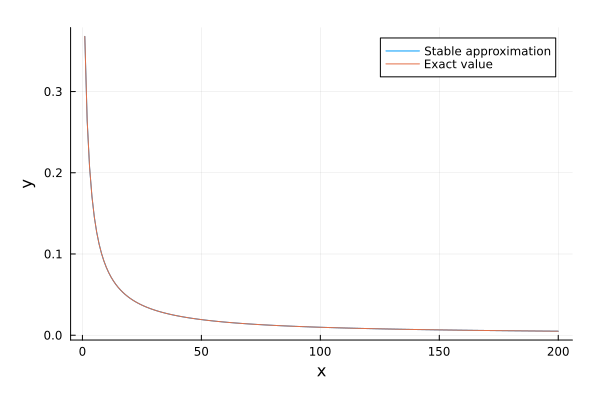

In [17]:
goodAproxRange = 1:200
p1 = plot(goodAproxRange, goodDf[goodAproxRange, :stable],label="Stable approximation",xlabel = "x",ylabel = "y",margin = 5Plots.mm)
plot!(goodAproxRange, goodDf[goodAproxRange, :integral],label="Exact value",xlabel = "x",ylabel = "y",margin = 5Plots.mm)